## Cargamos el dataset

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import metnum
# Carquemos el dataset 
df_train = pd.read_csv("../data/train.csv")
# Veamos el tamaño
display("Dimensiones: ", df_train.shape)
# Y sus primeras filas 
pd.set_option("display.max.columns", None)
df_train.head(5)

'Dimensiones: '

(240000, 23)

,id,titulo,descripcion,tipodepropiedad,direccion,ciudad,provincia,antiguedad,habitaciones,garages,banos,metroscubiertos,metrostotales,idzona,lat,lng,fecha,gimnasio,usosmultiples,piscina,escuelascercanas,centroscomercialescercanos,precio
0,254099,depto. tipo a-402,"depto. interior de 80.15m2, consta de sala com...",Apartamento,Avenida Division del Norte 2005,Benito Juárez,Distrito Federal,NaN,2.0,1.0,2.0,80.0,80.0,23533.0,NaN,NaN,2015-08-23 00:00:00,0.0,0.0,0.0,0.0,0.0,2273000.0
1,53461,condominio horizontal en venta,"<p>entre sonora y guerrero, atr&aacute;s del h...",Casa en condominio,AV. MEXICO,La Magdalena Contreras,Distrito Federal,10.0,3.0,2.0,2.0,268.0,180.0,24514.0,19.310205,-99.227655,2013-06-28 00:00:00,0.0,0.0,0.0,1.0,1.0,3600000.0
2,247984,casa en venta urbi 3 recamaras tonala,descripcion \nla mejor ubicacion residencial e...,Casa,Urbi Tonala,Tonalá,Jalisco,5.0,3.0,2.0,2.0,144.0,166.0,48551.0,NaN,NaN,2015-10-17 00:00:00,0.0,0.0,0.0,0.0,0.0,1200000.0
3,209067,casa sola en toluca zinacantepec con credito i...,casa en privada con caseta de vigilancia casas...,Casa,IGNACIO MANUEL ALTAMIRANO 128,Zinacantepec,Edo. de México,1.0,2.0,1.0,1.0,63.0,67.0,53666.0,19.301890,-99.688015,2012-03-09 00:00:00,0.0,0.0,0.0,1.0,1.0,650000.0
4,185997,paseos del sol,bonito departamento en excelentes condiciones ...,Apartamento,PASEOS DEL SOL,Zapopan,Jalisco,10.0,2.0,1.0,1.0,95.0,95.0,47835.0,NaN,NaN,2016-06-07 00:00:00,0.0,0.0,0.0,0.0,0.0,1150000.0


In [2]:
# Importo las funciones necesarias desde otro archivo nuestro
from extra_scripts import cross_validate, rmse, rmsle

# Experimento 2:
## Estimar precio en funcion de la localización del inmueble

(116512, 23)

Rango de Longitud: (-125.859375, 121.036)
Rango de Latitud: (-100.886679, 83.02621885344844)


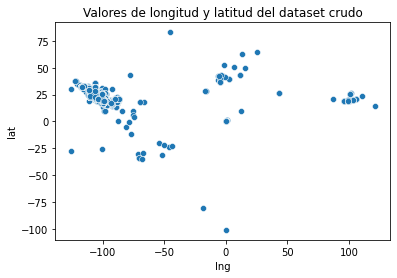

In [3]:
# Me quedo solo con los que no tenga NaN en lng y lat
df_train_clean = df_train[df_train["lng"].notna()]
df_train_clean = df_train_clean[df_train["lat"].notna()]

display(df_train_clean.shape)

print("Rango de Longitud:", (np.min(df_train_clean["lng"]), np.max(df_train_clean["lng"])))
print("Rango de Latitud:", (np.min(df_train_clean["lat"]), np.max(df_train_clean["lat"])))

hmax = sns.scatterplot(data=df_train_clean, x="lng", y="lat")

plt.title("Valores de longitud y latitud del dataset crudo")
plt.show()

In [4]:
# Delimito los margenes de mexico
lng_min_mex = -117.279
lng_max_mex = -86.122
lat_min_mex = 14.945
lat_max_mex = 32.676

df_train_clean = df_train_clean[df_train_clean["lng"] <= lng_max_mex]
df_train_clean = df_train_clean[df_train_clean["lat"] <= lat_max_mex]
df_train_clean = df_train_clean[lng_min_mex <= df_train_clean["lng"]]
df_train_clean = df_train_clean[lat_min_mex <= df_train_clean["lat"]]

df_train_clean.shape

(115853, 23)

Rango de Longitud: (-117.12352242090151, -86.69609785079956)
Rango de Latitud: (15.140132412093287, 32.6682830801994)


<Figure size 432x288 with 0 Axes>

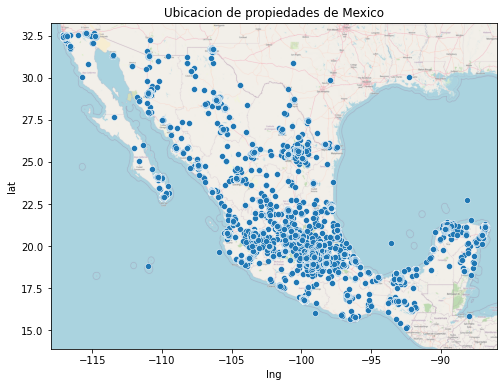

In [5]:
print("Rango de Longitud:", (np.min(df_train_clean["lng"]), np.max(df_train_clean["lng"])))
print("Rango de Latitud:", (np.min(df_train_clean["lat"]), np.max(df_train_clean["lat"])))

import matplotlib.image as mpimg
map_img = mpimg.imread('mapas/map_mex.png') 

plt.figure()
plt.figure(figsize=(8,6))
hmax = sns.scatterplot(data=df_train_clean, x="lng", y="lat")

# valores seteados con ayuda del EXPORT de openstreetmap
#hmax.set_xlim(-122.5, -84.8) 
#hmax.set_ylim(13.5, 35.2)
hmax.set_ylim(13.901, 33.274)
hmax.set_xlim(-117.993, -85.957)

hmax.imshow(map_img, aspect = hmax.get_aspect(), extent = hmax.get_xlim() + hmax.get_ylim())

plt.title("Ubicacion de propiedades de Mexico")
plt.show()

In [6]:
# Creo una funcion lista para plotear los mapas del DF y GU
import matplotlib.image as mpimg
def plot_map (ciudad, df_pred, save_name = None, title = None, dot_size = 50):
    # Importo el mapa 
    map_img = mpimg.imread(f'mapas/map{ciudad}.png') 

    plt.figure()
    if ciudad=="DF":
        plt.figure(figsize=(6,8))
    elif ciudad=="GU":
        plt.figure(figsize=(8,8))

    # Preparo los puntos para el colorbar
    points = plt.scatter(df_pred["lng"], df_pred["lat"], c=df_pred["precio"], s=dot_size, cmap="plasma")
    plt.colorbar(points)

    hmax = sns.regplot("lng", "lat", data=df_pred, scatter=False, fit_reg=False, color=".1")
    if ciudad=="DF":
        hmax.set_ylim(lat_min_mex_DF, lat_max_mex_DF)
        hmax.set_xlim(lng_min_mex_DF, lng_max_mex_DF)
    elif ciudad=="GU":
        hmax.set_ylim(lat_min_mex_GU, lat_max_mex_GU)
        hmax.set_xlim(lng_min_mex_GU, lng_max_mex_GU)

    hmax.imshow(map_img, aspect = hmax.get_aspect(), extent = hmax.get_xlim() + hmax.get_ylim())
    if title != None:
        plt.title(title)
    if save_name != None:
        plt.savefig(f'Exp2/Precio-por-ubicacion-{ciudad}-{save_name}.png', bbox_inches = "tight")
    plt.show()

## Ajusto para la zona del df

In [7]:

# Delimito los margenes de mexico
lng_min_mex_DF = -99.3748
lng_max_mex_DF = -98.9250
lat_min_mex_DF = 19.0394
lat_max_mex_DF = 19.6012

df_train_clean_DF = df_train_clean[df_train_clean["lng"] <= lng_max_mex_DF]
df_train_clean_DF = df_train_clean_DF[df_train_clean["lat"] <= lat_max_mex_DF]
df_train_clean_DF = df_train_clean_DF[lng_min_mex_DF <= df_train_clean["lng"]]
df_train_clean_DF = df_train_clean_DF[lat_min_mex_DF <= df_train_clean["lat"]]

df_train_clean_DF.shape

(44558, 23)

<Figure size 432x288 with 0 Axes>

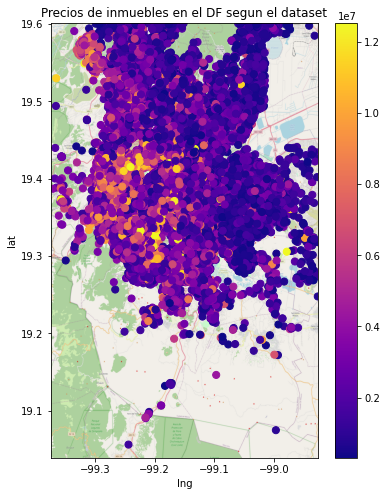

In [8]:
#Ploteo del mapa del DF con los datos del dataset
plot_map("DF", df_train_clean_DF, "original", "Precios de inmuebles en el DF segun el dataset")

## Ajuste para la zona de guadalajara

In [9]:
# Delimito los margenes de guadalajara
lng_min_mex_GU = -103.4696
lng_max_mex_GU = -103.1984
lat_min_mex_GU = 20.5203
lat_max_mex_GU = 20.7462

df_train_clean_GU = df_train_clean[df_train_clean["lng"] <= lng_max_mex_GU]
df_train_clean_GU = df_train_clean_GU[df_train_clean["lat"] <= lat_max_mex_GU]
df_train_clean_GU = df_train_clean_GU[lng_min_mex_GU <= df_train_clean["lng"]]
df_train_clean_GU = df_train_clean_GU[lat_min_mex_GU <= df_train_clean["lat"]]

df_train_clean_GU.shape

(9228, 23)

<Figure size 432x288 with 0 Axes>

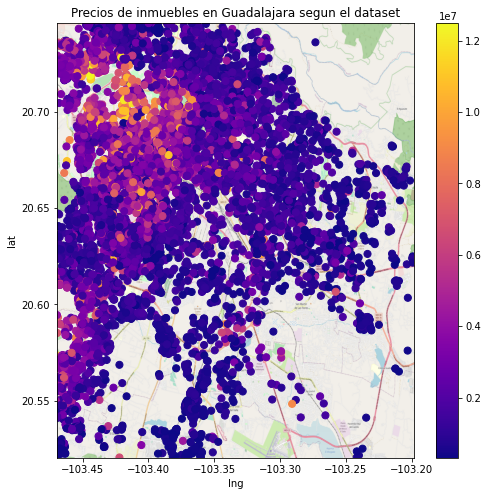

In [10]:
#Ploteo del mapa del GU con los datos del dataset
plot_map("GU", df_train_clean_GU, "original", "Precios de inmuebles en Guadalajara segun el dataset")

## Fiteo para el DF

OBS: Equiparo el tamaño del dataset de DF y GU, es decir que voy a tomar 10mil muestras para DF y todas las de GU (aprox 9300)

In [11]:
# Randomizo los valores del DF y me quedo con un 20% para testing
limite = 10000
cant_train = int((limite / 100) * 80)
shuffle = df_train_clean_DF.sample(random_state=np.random.seed(1), frac=1)
new_train = shuffle.iloc[:cant_train, :]
new_test = shuffle.iloc[cant_train:limite, :]
x_train, x_test = new_train[["lng", "lat"]].values, new_test[["lng", "lat"]].values
y_train, y_test = new_train["precio"].values, new_test["precio"].values

# Agrego otra familia de funciones (lng*lat, lng^2, lat^2)
x_train = np.column_stack([x_train, x_train[:, 0] ** 2, x_train[:, 0] * x_train[:, 1], x_train[:, 1] ** 2])
x_test = np.column_stack([x_test, x_test[:, 0] ** 2, x_test[:, 0] * x_test[:, 1], x_test[:, 1] ** 2])
print(f"train: {x_train.shape}, test: {x_test.shape}")

# Ahora queremos entrenar el modelo (ESTO SOLO ES PARA DIBUJAR, Solo deberia usar cross validation)
modelo = metnum.LinearRegression()
modelo.fit(x_train, y_train)
y_pred = modelo.predict(x_test)

train: (8000, 5), test: (2000, 5)


In [12]:
# Metricas del conjunto de training
results_DF = cross_validate(10, x_train, y_train, True, True)

Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
RMSE = (2287985.920137849, 90443.37608541295)
RMSLE = (0.7514780433308288, 0.01934219763091365)
R2 = (0.149055033512768, 0.017573418642458326)


In [13]:
# Veamos que tan bien se acercan los resultados en el mapa

x_train = np.column_stack([x_test[:, 0], x_test[:, 1], y_pred])
df_pred_DF = pd.DataFrame(x_train, columns=["lng","lat","precio"])

print(df_pred_DF.shape)

(2000, 3)


<Figure size 432x288 with 0 Axes>

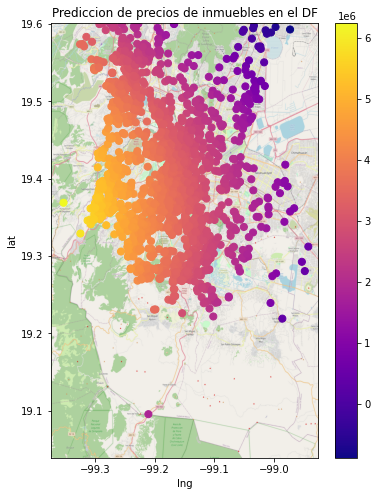

In [14]:
#Ploteo del mapa del DF con los datos de la prediccion
plot_map ("DF", df_pred_DF, "prediccion", "Prediccion de precios de inmuebles en el DF")

## Fiteo para GU

In [15]:
# Randomizo los valores de GU y me quedo con un 20% para testing
limite = df_train_clean_GU.shape[0]
cant_train = int((limite / 100) * 80)
shuffle = df_train_clean_GU.sample(random_state=np.random.seed(1), frac=1)
new_train = shuffle.iloc[:cant_train, :]
new_test = shuffle.iloc[cant_train:limite, :]
x_train, x_test = new_train[["lng", "lat"]].values, new_test[["lng", "lat"]].values
y_train, y_test = new_train["precio"].values, new_test["precio"].values

# Agrego otra familia de funciones (lng*lat, lng^2, lat^2)
x_train = np.column_stack([x_train, x_train[:, 0] ** 2, x_train[:, 0] * x_train[:, 1], x_train[:, 1] ** 2])
x_test = np.column_stack([x_test, x_test[:, 0] ** 2, x_test[:, 0] * x_test[:, 1], x_test[:, 1] ** 2])
print(f"train: {x_train.shape}, test: {x_test.shape}")

# Ahora queremos entrenar el modelo (ESTO SOLO ES PARA DIBUJAR, Solo deberia usar cross validation)
modelo = metnum.LinearRegression()
modelo.fit(x_train, y_train)
y_pred = modelo.predict(x_test)

train: (7382, 5), test: (1846, 5)


In [16]:
# Metricas del conjunto de training
results_GU = cross_validate(10, x_train, y_train, True)

Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
RMSE = (1882508.2709113401, 54700.0109149104)
RMSLE = (0.7386861836200243, 0.020041858142296438)


In [17]:
# Veamos que tan bien se acercan los resultados en el mapa

x_train = np.column_stack([x_test[:, 0], x_test[:, 1], y_pred])
df_pred_GU = pd.DataFrame(x_train, columns=["lng","lat","precio"])

print(df_pred_GU.shape)

(1846, 3)


<Figure size 432x288 with 0 Axes>

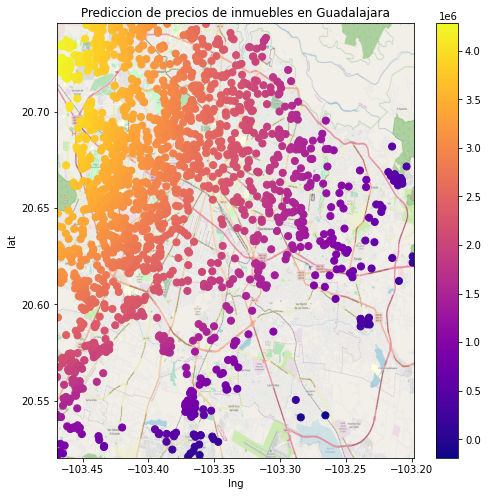

In [18]:
#Ploteo del mapa del GU con los datos de la prediccion
plot_map ("GU", df_pred_GU, "prediccion", "Prediccion de precios de inmuebles en Guadalajara")

## Refinemos lo obtenido con una nueva feature

La feature engineering que planeamos agregar seria precio por m^2, donde tomaremos como dato de dimension a los metros cubiertos. De esta forma se entrenara con el valor del precio por m^2, pero al obtener la prediccion se obtendra el precio de vuelta, ya que ese es el dato que necesitamos predecir.

In [19]:
#Limpiamos el campo de metroscubiertos
print(df_train_clean_DF.shape)
print(df_train_clean_GU.shape)

df_train_clean_DF = df_train_clean_DF[df_train_clean_DF['metroscubiertos'].notna()]
df_train_clean_GU = df_train_clean_GU[df_train_clean_GU['metroscubiertos'].notna()]

#Creamos una nueva columna para los dos datasets
df_train_clean_DF['precio_por_m2'] = df_train_clean_DF['precio'] / df_train_clean_DF['metroscubiertos']
df_train_clean_GU['precio_por_m2'] = df_train_clean_GU['precio'] / df_train_clean_GU['metroscubiertos']

print(df_train_clean_DF.shape)
print(df_train_clean_GU.shape)

(44558, 23)
(9228, 23)
(41990, 24)
(8576, 24)


### Analisis del DF

In [20]:
# Randomizo los valores del DF y me quedo con un 20% para testing
limite = 10000
cant_train = int((limite / 100) * 80)
shuffle = df_train_clean_DF.sample(random_state=np.random.seed(1), frac=1)
new_train = shuffle.iloc[:cant_train, :]
new_test = shuffle.iloc[cant_train:limite, :]
x_train, x_test = new_train[["lng", "lat"]].values, new_test[["lng", "lat"]].values
y_train, y_test = new_train["precio_por_m2"].values, new_test["precio_por_m2"].values

# Agrego otra familia de funciones (lng*lat, lng^2, lat^2)
x_train = np.column_stack([x_train, x_train[:, 0] ** 2, x_train[:, 0] * x_train[:, 1], x_train[:, 1] ** 2])
x_test = np.column_stack([x_test, x_test[:, 0] ** 2, x_test[:, 0] * x_test[:, 1], x_test[:, 1] ** 2])
print(f"train: {x_train.shape}, test: {x_test.shape}")

# Ahora queremos entrenar el modelo (ESTO SOLO ES PARA DIBUJAR, Solo deberia usar cross validation)
modelo = metnum.LinearRegression()
modelo.fit(x_train, y_train)
y_pred = modelo.predict(x_test)
y_pred = y_pred.reshape(y_pred.shape[0],)

train: (8000, 5), test: (2000, 5)


In [21]:
# en y_pred tengo el precio/m^2
print(y_pred[:5])
print(new_test['metroscubiertos'].values[:5])

y_pred_precio = np.multiply(y_pred, new_test['metroscubiertos'].values)
print(y_pred_precio[:5])

[19170.7035661  23696.73195204 27009.77422407 23214.16422647
 22338.66355601]
[340.  60. 221.  81.  64.]
[6518039.21247542 1421803.91712248 5969160.10352007 1880347.30234426
 1429674.46758461]


In [22]:
# Metricas del conjunto de training
results_DF_2 = cross_validate(10, x_train, y_train, True, True)

Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
Error! Se obtuvo un negativo, se procede a tomar el valor absoluto
RMSE = (11859.848976943988, 1390.6312833647444)
RMSLE = (0.5597810767117151, 0.028178074626187828)
R2 = (0.12622124956235742, 0.02800457562380798)


In [23]:
#Veamos que tan bien se acercan los resultados en el mapa

x_train = np.column_stack([x_test[:, 0], x_test[:, 1], y_pred_precio])

print(x_train.shape)

df_pred_DF = pd.DataFrame(x_train, columns=["lng","lat","precio"])



print(df_pred_DF.shape)

(2000, 3)
(2000, 3)


<Figure size 432x288 with 0 Axes>

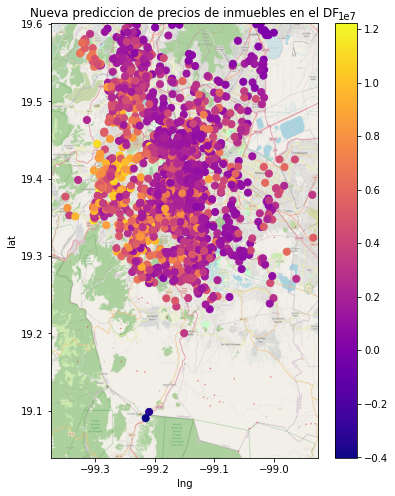

In [24]:
#Ploteo del mapa del DF con los datos de la prediccion
plot_map ("DF", df_pred_DF, "prediccion-mejorada", "Nueva prediccion de precios de inmuebles en el DF")

### Analisis de GU

In [25]:
# Randomizo los valores del DF y me quedo con un 20% para testing
limite = df_train_clean_GU.shape[0]
cant_train = int((limite / 100) * 80)
shuffle = df_train_clean_GU.sample(random_state=np.random.seed(1), frac=1)
new_train = shuffle.iloc[:cant_train, :]
new_test = shuffle.iloc[cant_train:limite, :]
x_train, x_test = new_train[["lng", "lat"]].values, new_test[["lng", "lat"]].values
y_train, y_test = new_train["precio_por_m2"].values, new_test["precio_por_m2"].values

# Agrego otra familia de funciones (lng*lat, lng^2, lat^2)
x_train = np.column_stack([x_train, x_train[:, 0] ** 2, x_train[:, 0] * x_train[:, 1], x_train[:, 1] ** 2])
x_test = np.column_stack([x_test, x_test[:, 0] ** 2, x_test[:, 0] * x_test[:, 1], x_test[:, 1] ** 2])
print(f"train: {x_train.shape}, test: {x_test.shape}")

# Ahora queremos entrenar el modelo (ESTO SOLO ES PARA DIBUJAR, Solo deberia usar cross validation)
modelo = metnum.LinearRegression()
modelo.fit(x_train, y_train)
y_pred = modelo.predict(x_test)
y_pred = y_pred.reshape(y_pred.shape[0],)

train: (6860, 5), test: (1716, 5)


In [26]:
# en y_pred tengo el precio/m^2
print(y_pred[:5])
print(new_test['metroscubiertos'].values[:5])

# Por lo que quiero obtener el precio normal
y_pred_precio = y_pred * new_test['metroscubiertos'].values
print(y_pred_precio[:5])

[15813.76791996 15771.21579364 11849.31744456 13599.85766342
 17824.29995674]
[143. 244.  52. 325. 262.]
[2261368.81255394 3848176.65364802  616164.50711727 4419953.74061242
 4669966.5886656 ]


In [27]:
# Metricas del conjunto de training
results_GU_2 = cross_validate(10, x_train, y_train, True, True)

RMSE = (7556.064460246374, 1162.7756614085145)
RMSLE = (0.44677747135654844, 0.020685817948663015)
R2 = (0.14677343349263397, 0.03494845707256445)


In [28]:
#Veamos que tan bien se acercan los resultados en el mapa

x_train = np.column_stack([x_test[:, 0], x_test[:, 1], y_pred_precio])
df_pred_GU = pd.DataFrame(x_train, columns=["lng","lat","precio"])

print(df_pred_GU.shape)

(1716, 3)


<Figure size 432x288 with 0 Axes>

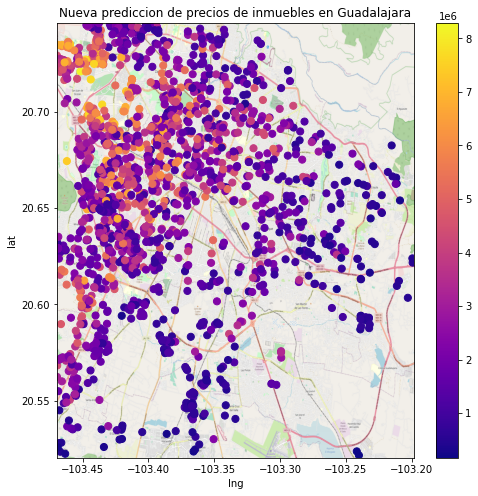

In [29]:
#Ploteo del mapa de GU con los datos de la prediccion
plot_map ("GU", df_pred_GU, "prediccion-mejorada", "Nueva prediccion de precios de inmuebles en Guadalajara")

### Comparemos metricas

In [30]:
#Muestro las diferencias entre los dos resultados en una tabla
U_DF_rmse,  V_DF_rmse   = np.mean(results_DF["RMSE"]),  np.std(results_DF["RMSE"])
U_DF_rmsle, V_DF_rmsle  = np.mean(results_DF["RMSLE"]), np.std(results_DF["RMSLE"])
U_DF_r2,    V_DF_r2     = np.mean(results_DF["R2"]),    np.std(results_DF["R2"])

U_DF_rmse_2,  V_DF_rmse_2   = np.mean(results_DF_2["RMSE"]),  np.std(results_DF_2["RMSE"])
U_DF_rmsle_2, V_DF_rmsle_2  = np.mean(results_DF_2["RMSLE"]), np.std(results_DF_2["RMSLE"])
U_DF_r2_2,    V_DF_r2_2     = np.mean(results_DF_2["R2"]),    np.std(results_DF_2["R2"])

print("Normal")
print(f" - RMSE  = {(U_DF_rmse,  V_DF_rmse)}")
print(f" - RMSLE = {(U_DF_rmsle, V_DF_rmsle)}")
print(f" - R2    = {(U_DF_r2,    V_DF_r2)}")

print("Refinado")
print(f" - RMSE  = {(U_DF_rmse_2,  V_DF_rmse_2)}")
print(f" - RMSLE = {(U_DF_rmsle_2, V_DF_rmsle_2)}")
print(f" - R2    = {(U_DF_r2_2,    V_DF_r2_2)}")

print("Diferencias")
print(f" - RMSE  = {(U_DF_rmse - U_DF_rmse_2,   V_DF_rmse - V_DF_rmse_2)}")
print(f" - RMSLE = {(U_DF_rmsle - U_DF_rmsle_2, V_DF_rmsle - V_DF_rmsle_2)}")
print(f" - R2    = {(U_DF_r2 - U_DF_r2_2,       V_DF_r2 - V_DF_r2_2)}")

Normal
 - RMSE  = (2287985.920137849, 90443.37608541295)
 - RMSLE = (0.7514780433308288, 0.01934219763091365)
 - R2    = (0.149055033512768, 0.017573418642458326)
Refinado
 - RMSE  = (11859.848976943988, 1390.6312833647444)
 - RMSLE = (0.5597810767117151, 0.028178074626187828)
 - R2    = (0.12622124956235742, 0.02800457562380798)
Diferencias
 - RMSE  = (2276126.071160905, 89052.74480204821)
 - RMSLE = (0.19169696661911373, -0.008835876995274178)
 - R2    = (0.02283378395041058, -0.010431156981349655)


In [31]:
#Muestro las diferencias entre los dos resultados en una tabla
U_GU_rmse,  V_GU_rmse   = np.mean(results_GU["RMSE"]),  np.std(results_GU["RMSE"])
U_GU_rmsle, V_GU_rmsle  = np.mean(results_GU["RMSLE"]), np.std(results_GU["RMSLE"])
U_GU_r2,    V_GU_r2     = np.mean(results_GU["R2"]),    np.std(results_GU["R2"])

U_GU_rmse_2,  V_GU_rmse_2   = np.mean(results_GU_2["RMSE"]),  np.std(results_GU_2["RMSE"])
U_GU_rmsle_2, V_GU_rmsle_2  = np.mean(results_GU_2["RMSLE"]), np.std(results_GU_2["RMSLE"])
U_GU_r2_2,    V_GU_r2_2     = np.mean(results_GU_2["R2"]),    np.std(results_GU_2["R2"])

print("Normal")
print(f" - RMSE  = {(U_GU_rmse,  V_GU_rmse)}")
print(f" - RMSLE = {(U_GU_rmsle, V_GU_rmsle)}")
print(f" - R2    = {(U_GU_r2,    V_GU_r2)}")

print("Refinado")
print(f" - RMSE  = {(U_GU_rmse_2,  V_GU_rmse_2)}")
print(f" - RMSLE = {(U_GU_rmsle_2, V_GU_rmsle_2)}")
print(f" - R2    = {(U_GU_r2_2,    V_GU_r2_2)}")

print("Diferencias")
print(f" - RMSE  = {(U_GU_rmse - U_GU_rmse_2,   V_GU_rmse - V_GU_rmse_2)}")
print(f" - RMSLE = {(U_GU_rmsle - U_GU_rmsle_2, V_GU_rmsle - V_GU_rmsle_2)}")
print(f" - R2    = {(U_GU_r2 - U_GU_r2_2,       V_GU_r2 - V_GU_r2_2)}")

Normal
 - RMSE  = (1882508.2709113401, 54700.0109149104)
 - RMSLE = (0.7386861836200243, 0.020041858142296438)
 - R2    = (0.1905400851692454, 0.02383130978484258)
Refinado
 - RMSE  = (7556.064460246374, 1162.7756614085145)
 - RMSLE = (0.44677747135654844, 0.020685817948663015)
 - R2    = (0.14677343349263397, 0.03494845707256445)
Diferencias
 - RMSE  = (1874952.2064510938, 53537.23525350189)
 - RMSLE = (0.2919087122634758, -0.0006439598063665772)
 - R2    = (0.04376665167661142, -0.011117147287721868)
